Import libraries

In [ ]:
import torch
from monai.utils import set_determinism
from monai.networks.nets import UNet
from monai.networks.layers import Norm

from tqdm import tqdm
import os

import pandas as pd
from sklearn.model_selection import train_test_split

from utils.data_load import get_data_list, get_case_dataset_3d
from utils.transforms import get_3D_transforms
from utils.inference import get_case_predictions_3d, evaluate_predictions
from utils.viz import plot_predictions_3D

Set determinism to `seed=42` and cuda to GPU (fallback CPU)

In [2]:
set_determinism(seed=42)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Device: {device}", flush=True)

Device: cuda


Set paths to dataset and model checkpoint

In [ ]:
DATA_ROOT = "/scratch/cv-course2025/lschind5/kits19/data"
NUM_WORKERS = 4
MODEL_PATH = "/home/group.kurse/cviwo008/Project/" # Update this path to your model path
MODEL_NAME = "kits19-model-3d-unet-V5.pth" # Update this to your model name

Verify if it has been loaded

In [4]:
all_cases = get_data_list(DATA_ROOT)
print(f"   Found {len(all_cases)} cases", flush=True)

   Found 210 cases


Load validation set

In [5]:
train_data, val_data = train_test_split(
    all_cases, test_size=0.2, random_state=42
)

val_cases = [case["case_id"] for case in val_data]
test_cases = [f"case_{i:05d}" for i in range(210, 299)]

Define UNet model as in 3D U-Net training

In [6]:
model = UNet(
    spatial_dims=3,
    in_channels=1,
    out_channels=3,
    channels=(30, 60, 120, 240, 320),
    strides=(2, 2, 2, 2),
    num_res_units=3,
    act="PRELU",
    norm=Norm.INSTANCE,
    dropout=0.0,
    kernel_size=3,
    up_kernel_size=3
)

Load checkpoint

In [7]:
checkpoint = torch.load(
    os.path.join(MODEL_PATH, MODEL_NAME), 
    map_location=device
)
model.load_state_dict(checkpoint)

model = model.to(device)

Get validation transforms pipeline

In [8]:
train_transforms, val_transforms = get_3D_transforms()

Version 2 of 3D transforms


Get prediction on validation set

In [9]:
val_data = {}
for case in tqdm(val_cases):
    print(case)
            
    case_dataset, case_image, case_label = get_case_dataset_3d(
        case, DATA_ROOT, val_transforms, NUM_WORKERS
    )
    case_predictions = get_case_predictions_3d(model, case_dataset, device)
    
    val_data[case] = {
        "case_id": case,
        "image": case_image,           # Original NIfTI image for metadata
        "ground_truth": case_label,    # Transformed label tensor (same space as predictions)
        "predictions": case_predictions # Predictions tensor (same space as ground_truth)
    }

  0%|                                                                                            | 0/42 [00:00<?, ?it/s]

case_00030


  2%|██                                                                                  | 1/42 [00:02<01:41,  2.47s/it]

case_00172


  5%|████                                                                                | 2/42 [00:06<02:04,  3.11s/it]

case_00084


  7%|██████                                                                              | 3/42 [00:13<03:13,  4.95s/it]

case_00199


 10%|████████                                                                            | 4/42 [00:16<02:45,  4.36s/it]

case_00060


 12%|██████████                                                                          | 5/42 [00:20<02:40,  4.33s/it]

case_00155


 14%|████████████                                                                        | 6/42 [00:30<03:45,  6.25s/it]

case_00045


 17%|██████████████                                                                      | 7/42 [00:33<02:54,  4.99s/it]

case_00182


 19%|████████████████                                                                    | 8/42 [00:37<02:41,  4.75s/it]

case_00009


 21%|██████████████████                                                                  | 9/42 [00:40<02:15,  4.10s/it]

case_00196


 24%|███████████████████▊                                                               | 10/42 [00:45<02:23,  4.49s/it]

case_00136


 26%|█████████████████████▋                                                             | 11/42 [00:49<02:14,  4.33s/it]

case_00187


 29%|███████████████████████▋                                                           | 12/42 [00:52<01:58,  3.94s/it]

case_00207


 31%|█████████████████████████▋                                                         | 13/42 [00:57<02:05,  4.34s/it]

case_00126


 33%|███████████████████████████▋                                                       | 14/42 [01:02<02:05,  4.49s/it]

case_00015


 36%|█████████████████████████████▋                                                     | 15/42 [01:05<01:47,  3.98s/it]

case_00073


 38%|███████████████████████████████▌                                                   | 16/42 [01:11<01:55,  4.46s/it]

case_00165


 40%|█████████████████████████████████▌                                                 | 17/42 [01:25<03:09,  7.58s/it]

case_00018


 43%|███████████████████████████████████▌                                               | 18/42 [01:29<02:34,  6.45s/it]

case_00168


 45%|█████████████████████████████████████▌                                             | 19/42 [01:32<02:05,  5.44s/it]

case_00093


 48%|███████████████████████████████████████▌                                           | 20/42 [01:46<02:54,  7.94s/it]

case_00075


 50%|█████████████████████████████████████████▌                                         | 21/42 [01:50<02:18,  6.60s/it]

case_00055


 52%|███████████████████████████████████████████▍                                       | 22/42 [01:54<01:59,  5.96s/it]

case_00147


 55%|█████████████████████████████████████████████▍                                     | 23/42 [01:57<01:38,  5.17s/it]

case_00109


 57%|███████████████████████████████████████████████▍                                   | 24/42 [02:00<01:18,  4.36s/it]

case_00108


 60%|█████████████████████████████████████████████████▍                                 | 25/42 [02:03<01:06,  3.92s/it]

case_00142


 62%|███████████████████████████████████████████████████▍                               | 26/42 [02:09<01:13,  4.57s/it]

case_00025


 64%|█████████████████████████████████████████████████████▎                             | 27/42 [02:12<01:02,  4.16s/it]

case_00125


 67%|███████████████████████████████████████████████████████▎                           | 28/42 [02:18<01:06,  4.78s/it]

case_00016


 69%|█████████████████████████████████████████████████████████▎                         | 29/42 [02:23<01:02,  4.77s/it]

case_00173


 71%|███████████████████████████████████████████████████████████▎                       | 30/42 [02:27<00:54,  4.54s/it]

case_00192


 74%|█████████████████████████████████████████████████████████████▎                     | 31/42 [02:32<00:51,  4.65s/it]

case_00069


 76%|███████████████████████████████████████████████████████████████▏                   | 32/42 [02:35<00:42,  4.25s/it]

case_00101


 79%|█████████████████████████████████████████████████████████████████▏                 | 33/42 [02:50<01:05,  7.30s/it]

case_00067


 81%|███████████████████████████████████████████████████████████████████▏               | 34/42 [02:56<00:55,  6.96s/it]

case_00104


 83%|█████████████████████████████████████████████████████████████████████▏             | 35/42 [03:01<00:44,  6.31s/it]

case_00132


 86%|███████████████████████████████████████████████████████████████████████▏           | 36/42 [03:11<00:44,  7.42s/it]

case_00180


 88%|█████████████████████████████████████████████████████████████████████████          | 37/42 [03:15<00:32,  6.45s/it]

case_00095


 90%|███████████████████████████████████████████████████████████████████████████        | 38/42 [03:22<00:27,  6.78s/it]

case_00082


 93%|█████████████████████████████████████████████████████████████████████████████      | 39/42 [03:26<00:17,  5.98s/it]

case_00159


 95%|███████████████████████████████████████████████████████████████████████████████    | 40/42 [03:39<00:16,  8.04s/it]

case_00197


 98%|█████████████████████████████████████████████████████████████████████████████████  | 41/42 [03:45<00:07,  7.22s/it]

case_00162


100%|███████████████████████████████████████████████████████████████████████████████████| 42/42 [03:48<00:00,  5.43s/it]


Calculate different metrics scores

In [10]:
metrics_standard_nofpbg, _ = evaluate_predictions(val_data, exclude_false_positives=True, slice_wise=False, exclude_background_slices=True)
metrics_standard_nobg, _ = evaluate_predictions(val_data, exclude_false_positives=False, slice_wise=False, exclude_background_slices=True)
metrics_standard_nofp, _ = evaluate_predictions(val_data, exclude_false_positives=True, slice_wise=False, exclude_background_slices=False)
metrics_slices, _ = evaluate_predictions(val_data, exclude_false_positives=False, slice_wise=True, exclude_background_slices=False)
metrics_slices_nofpbg, _ = evaluate_predictions(val_data, exclude_false_positives=True, slice_wise=True, exclude_background_slices=True)
metrics_slices_nobg, _ = evaluate_predictions(val_data, exclude_false_positives=False, slice_wise=True, exclude_background_slices=True)
metrics_slices_nofp, _ = evaluate_predictions(val_data, exclude_false_positives=True, slice_wise=True, exclude_background_slices=False)
metrics_standard, val_with_scores = evaluate_predictions(val_data, exclude_false_positives=False, slice_wise=False, exclude_background_slices=False)

After shape fix - GT: torch.Size([251, 203, 160]), Pred: torch.Size([251, 203, 160])
After shape fix - GT: torch.Size([219, 179, 161]), Pred: torch.Size([219, 179, 161])
After shape fix - GT: torch.Size([291, 233, 191]), Pred: torch.Size([291, 233, 191])
After shape fix - GT: torch.Size([226, 202, 160]), Pred: torch.Size([226, 202, 160])
After shape fix - GT: torch.Size([275, 207, 160]), Pred: torch.Size([275, 207, 160])
After shape fix - GT: torch.Size([258, 222, 160]), Pred: torch.Size([258, 222, 160])
After shape fix - GT: torch.Size([207, 169, 160]), Pred: torch.Size([207, 169, 160])
After shape fix - GT: torch.Size([242, 251, 164]), Pred: torch.Size([242, 251, 164])
After shape fix - GT: torch.Size([276, 175, 160]), Pred: torch.Size([276, 175, 160])
After shape fix - GT: torch.Size([233, 179, 186]), Pred: torch.Size([233, 179, 186])
After shape fix - GT: torch.Size([237, 228, 176]), Pred: torch.Size([237, 228, 176])
After shape fix - GT: torch.Size([193, 168, 160]), Pred: torch.Si

Output standard metric

In [11]:
metrics_standard

{'kidney_dice': 0.883218221721195,
 'tumor_dice': 0.6062623018141104,
 'bg_dice': 0.9990632065704891,
 'evaluation_mode': 'case-wise (3D)'}

Save metrics to csv

In [ ]:
# save in .csv
results = [metrics_standard, metrics_standard_nobg, metrics_standard_nofpbg, metrics_slices, metrics_slices_nofp, metrics_slices_nobg, metrics_slices_nofpbg]
df = pd.DataFrame(results)
os.makedirs(os.path.join(MODEL_PATH, "results"), exist_ok=True)
df.to_csv(os.path.join(MODEL_PATH, "results", "eval_results.csv"), index=False)

Plot predictions in 3D visualization space

Plotting case_00197: GT shape (269, 246, 171), Pred shape (269, 246, 171)


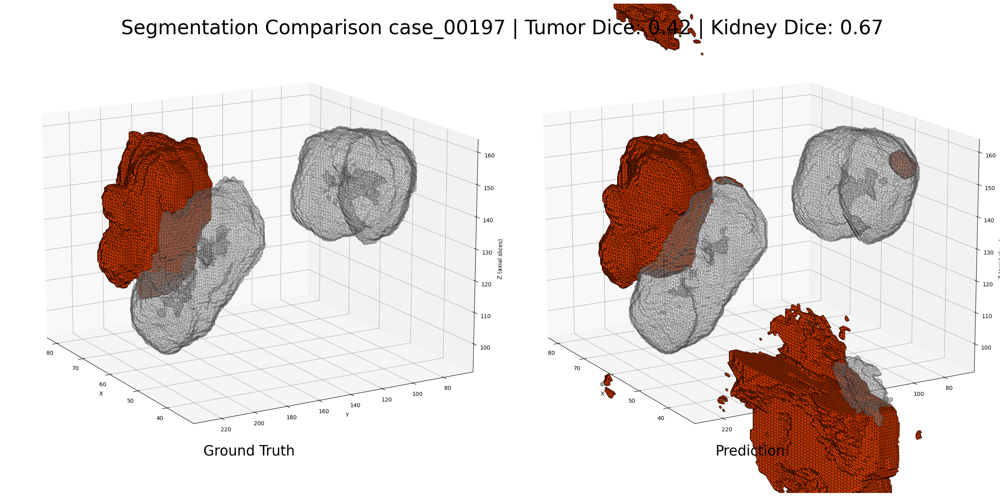

Plotting case_00109: GT shape (204, 160, 160), Pred shape (204, 160, 160)


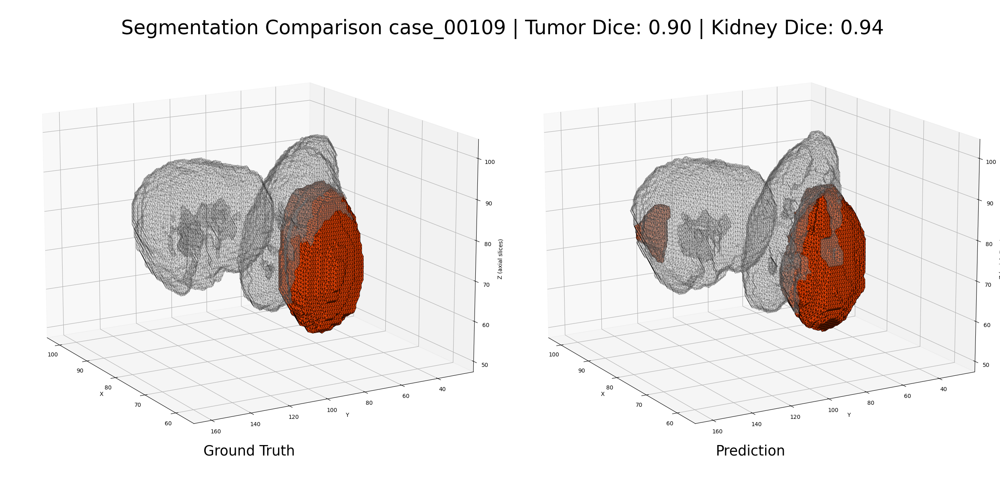

Plotting case_00067: GT shape (258, 201, 160), Pred shape (258, 201, 160)


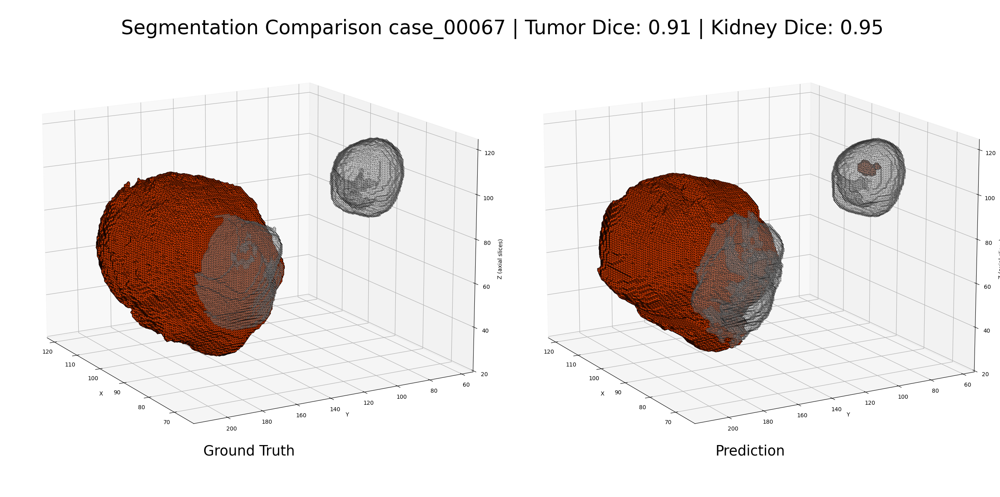

Plotting case_00172: GT shape (219, 179, 161), Pred shape (219, 179, 161)


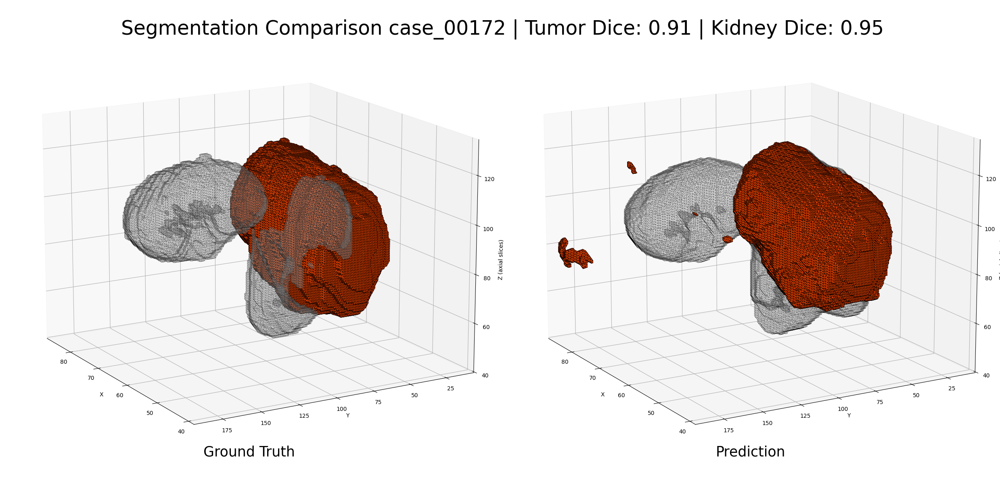

Plotting case_00126: GT shape (297, 262, 186), Pred shape (297, 262, 186)


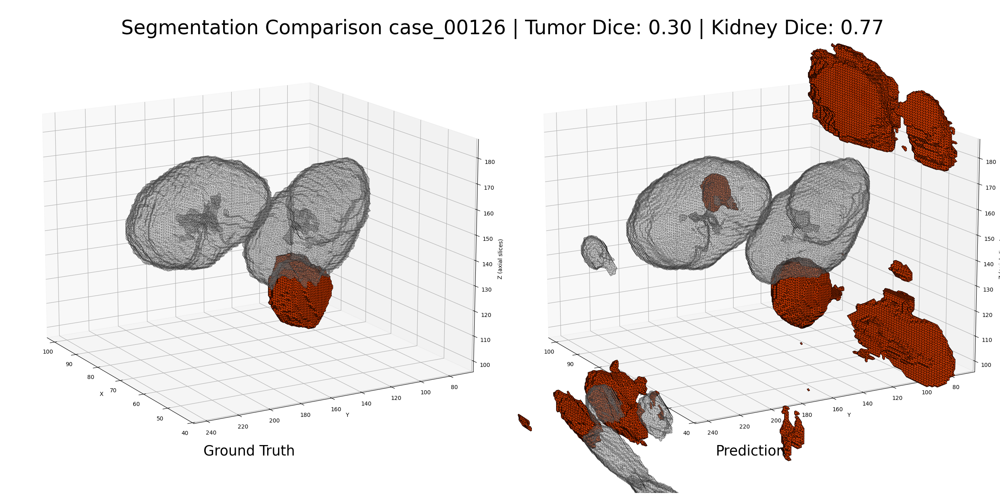

Plotting case_00192: GT shape (255, 212, 226), Pred shape (255, 212, 226)


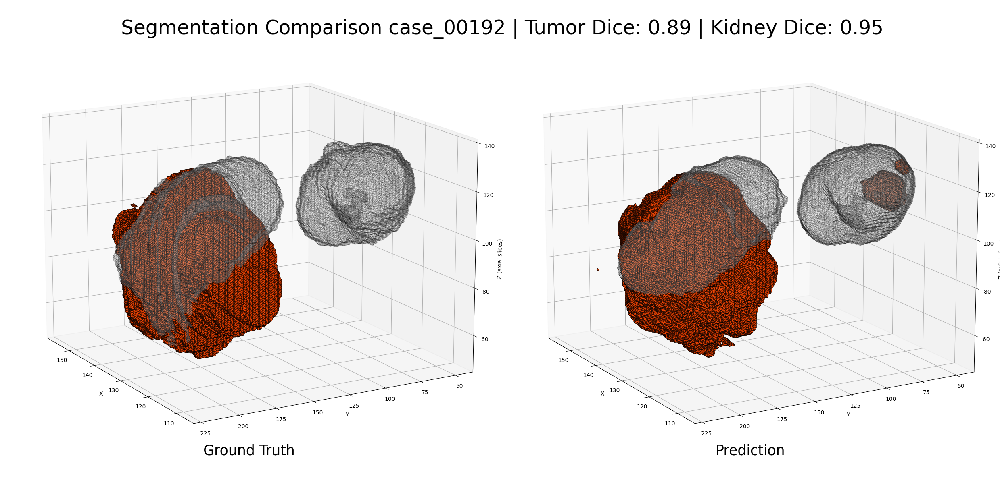

Plotting case_00093: GT shape (308, 273, 160), Pred shape (308, 273, 160)


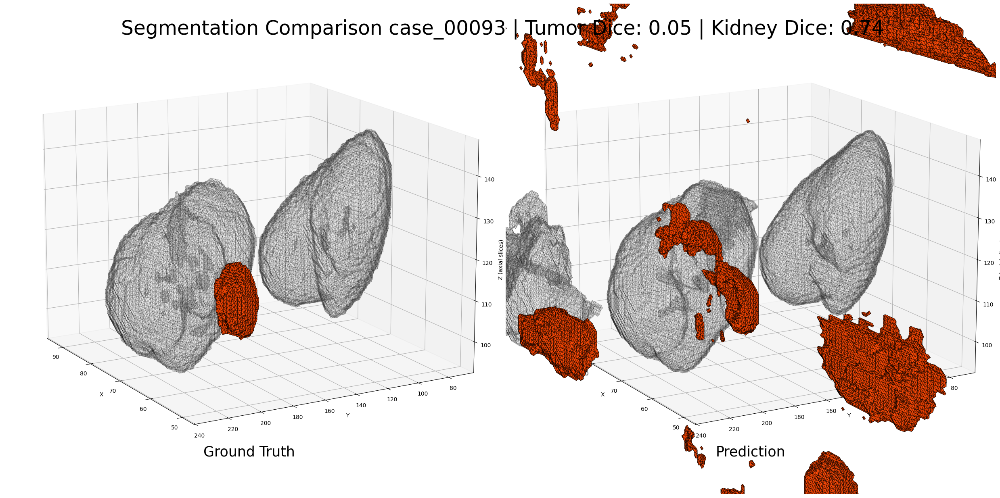

Plotting case_00075: GT shape (244, 198, 160), Pred shape (244, 198, 160)


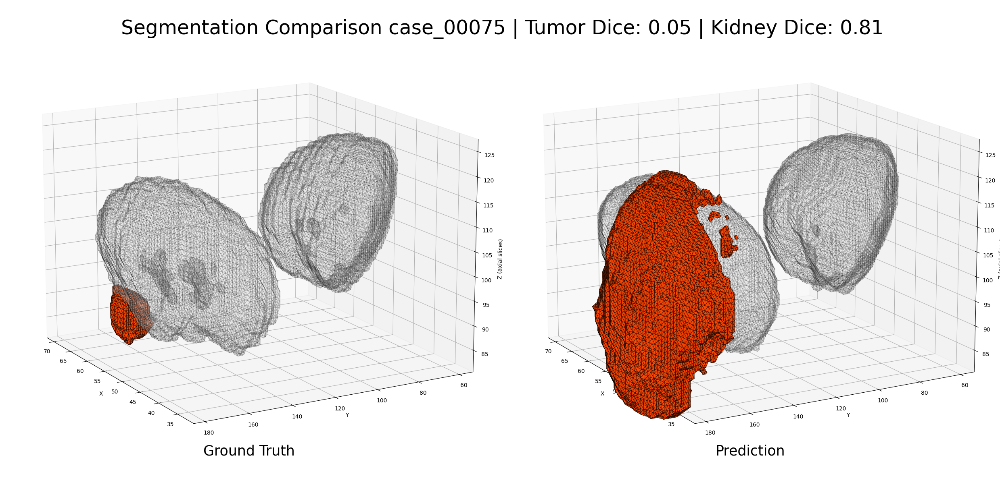

Plotting case_00196: GT shape (233, 179, 186), Pred shape (233, 179, 186)


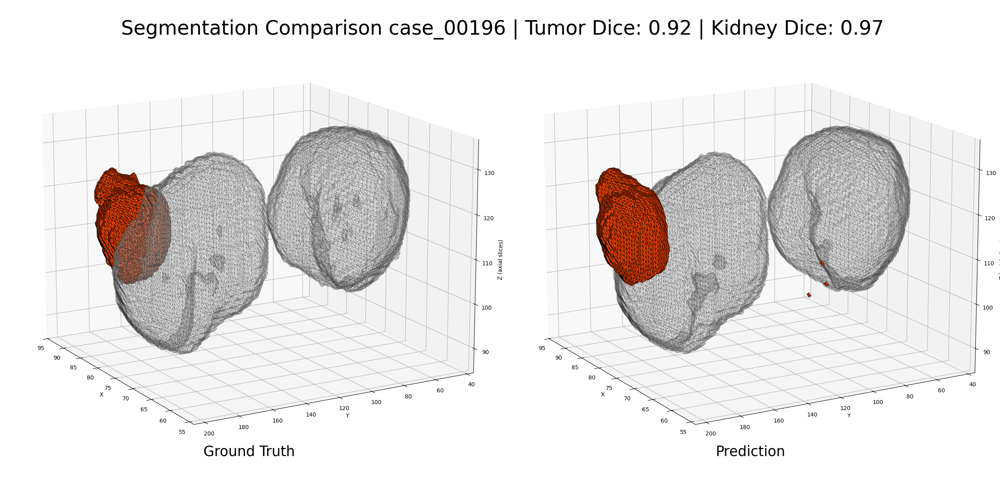

Plotting case_00125: GT shape (284, 228, 179), Pred shape (284, 228, 179)


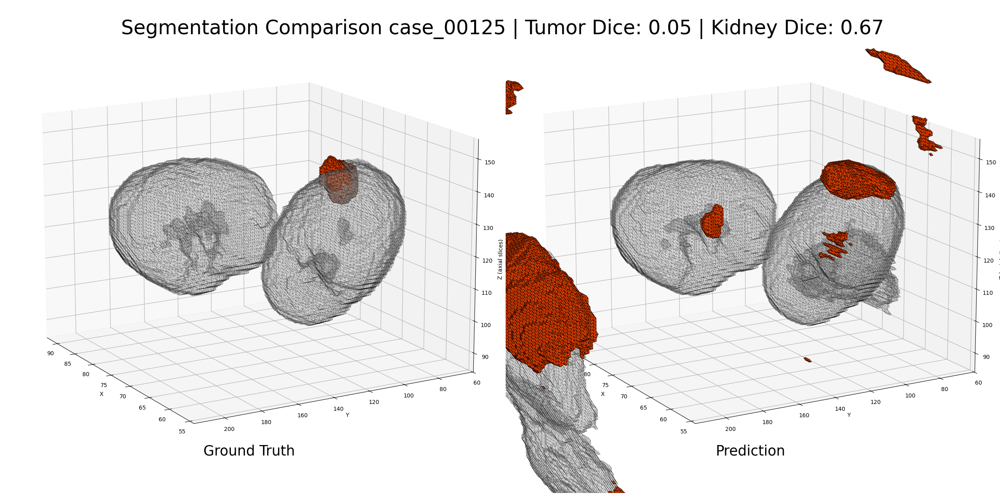

Plotting case_00082: GT shape (267, 199, 160), Pred shape (267, 199, 160)


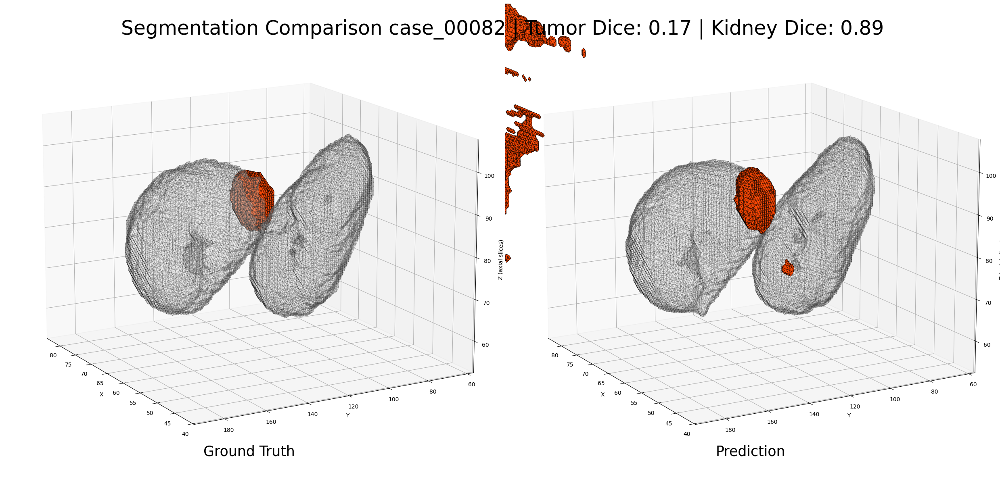

Plotting case_00015: GT shape (243, 205, 160), Pred shape (243, 205, 160)


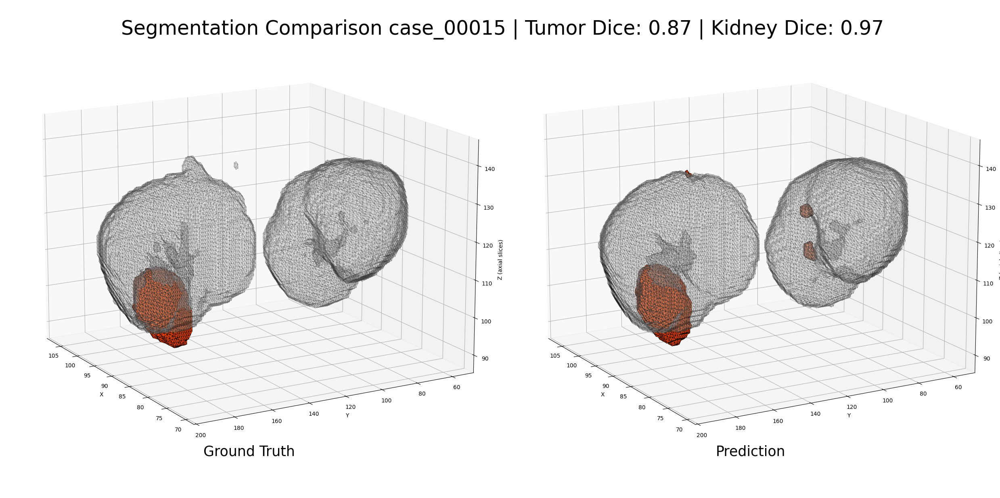

Plotting case_00142: GT shape (257, 207, 160), Pred shape (257, 207, 160)


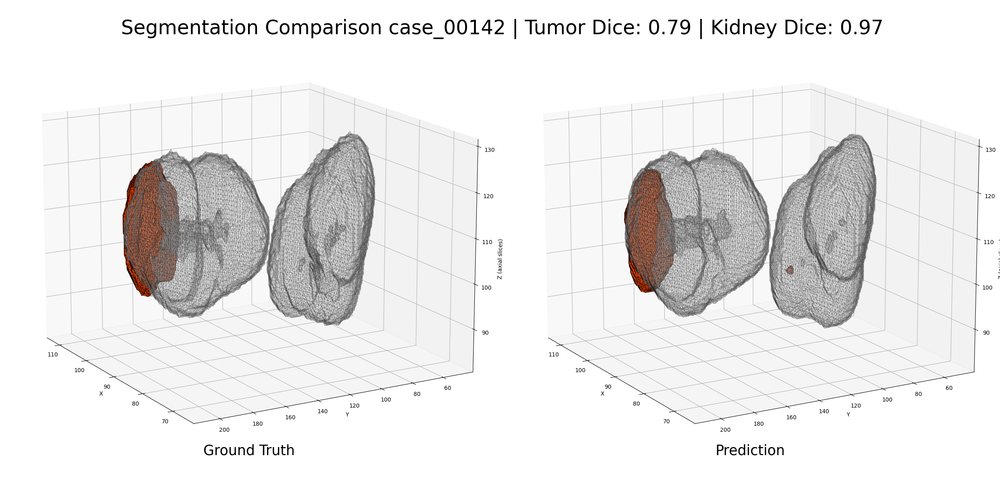

Plotting case_00101: GT shape (263, 193, 160), Pred shape (263, 193, 160)


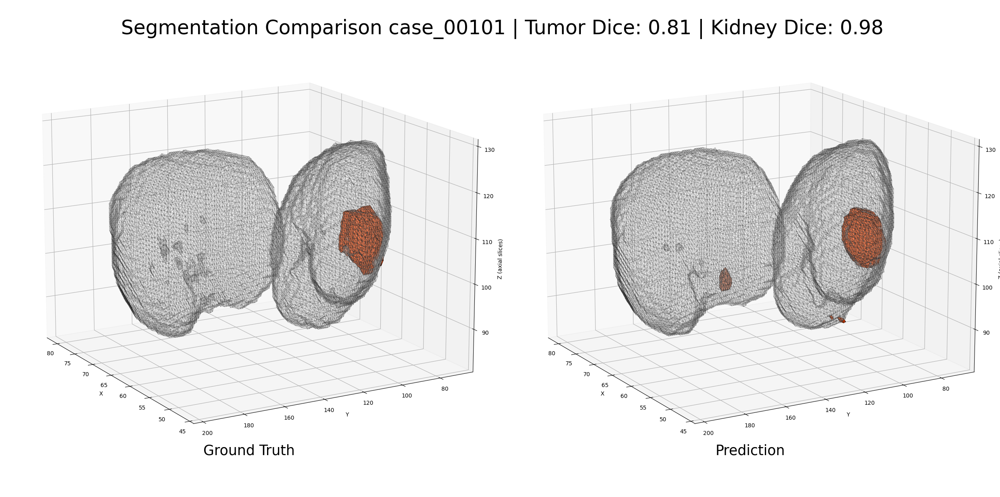

Plotting case_00165: GT shape (319, 269, 249), Pred shape (319, 269, 249)


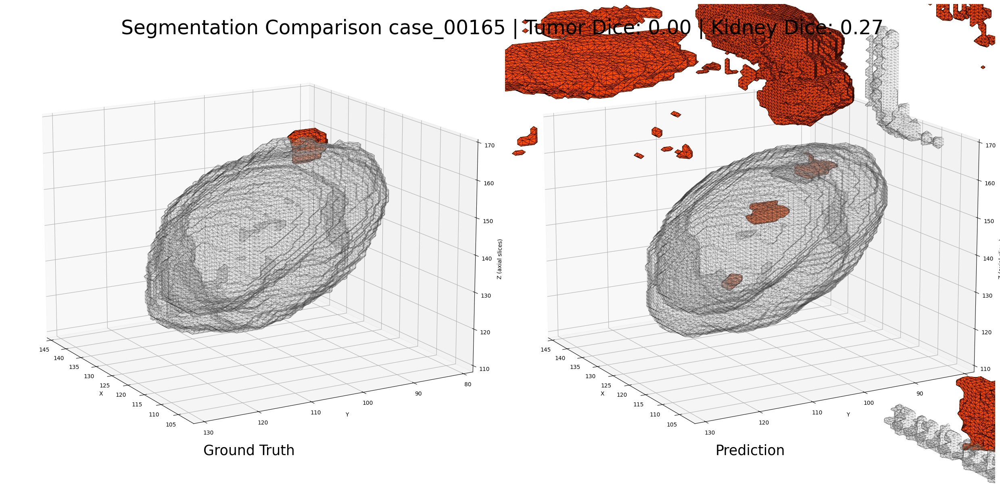

Plotting case_00132: GT shape (246, 187, 160), Pred shape (246, 187, 160)


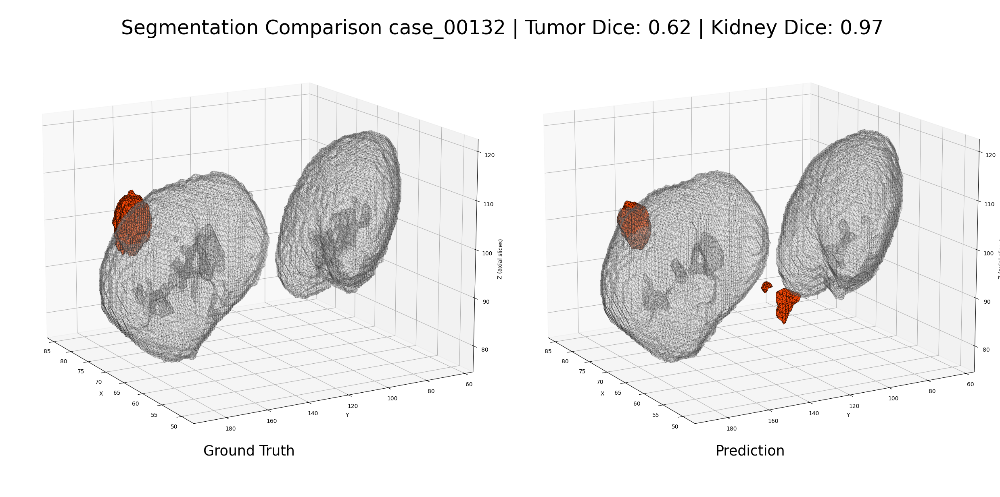

In [ ]:
# Select Cases: good kidney dice, bad kidney dice, good tumor dice, bad tumor dice
# Sort Cases by kidney dice
sorted_cases_kidney = sorted(val_with_scores.items(), key=lambda x: x[1]["kidney_dice"], reverse=True)
sorted_cases_tumor = sorted(val_with_scores.items(), key=lambda x: x[1]["tumor_dice"], reverse=True)

# Select best and worst cases
best_kidney_cases = [case_id for case_id, data in sorted_cases_kidney[:5]]  # Top 5 kidney cases
worst_kidney_cases = [case_id for case_id, data in sorted_cases_kidney[-5:]]  # Bottom 5 kidney cases
best_tumor_cases = [case_id for case_id, data in sorted_cases_tumor[:5]]  # Top 5 tumor cases
worst_tumor_cases = [case_id for case_id, data in sorted_cases_tumor[-5:]]  # Bottom 5 tumor cases

# Combine all selected case IDs into a single set (removes duplicates)
selected_case_ids = set(best_kidney_cases + worst_kidney_cases + best_tumor_cases + worst_tumor_cases)
selected_val_data = {case_id: val_with_scores[case_id] for case_id in selected_case_ids}

plot_predictions_3D(selected_val_data, output_path=os.path.join(MODEL_PATH, "results", "comparison"), model_type="3d")